In [8]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
from microphone import record_audio
from typing import Tuple
import librosa
from IPython.display import Audio
from scipy.ndimage.filters import maximum_filter
from scipy.ndimage.morphology import generate_binary_structure
from scipy.ndimage.morphology import iterate_structure
from typing import Callable

%matplotlib notebook

In [2]:
def librosa_resample(audio_path, target_sr: int) -> np.ndarray:
    """
    Give an audio file, an original sampling rate, and a target sampling rate, returns an array for resampled audio signal
    """
    y, sr = librosa.load(audio_path, sr=target_sr)
    return y, sr

In [11]:
def samples_to_spectrogram_and_peaks(data: np.ndarray, cutoff_fraction):
    %matplotlib inline
    fig, ax = plt.subplots()
    S, freqs, times, im = ax.specgram(
        data,
        NFFT=4096,
        Fs=sampling_rate,
        window=mlab.window_hanning,
        noverlap=4096 // 2, 
        mode='magnitude',
        scale="dB"
    )
    
    fig.colorbar(im)

    ax.set_xlabel("Time [seconds]")
    ax.set_ylabel("Frequency (Hz)")
    ax.set_title("Spectrogram of Recording")
    ax.set_ylim(0, 6000)

    #return fig, ax

    log_S = S.ravel()  # ravel flattens 2D spectrogram into a 1D array
    ind = round(len(log_S) * cutoff_fraction)  # find the index associated with the 60th percentile log-amplitude
    cutoff_log_amplitude = np.partition(log_S, ind)[ind]  # find the actual 60th percentile log-amplitude

    neighborhood_array = generate_binary_structure(2, 2)
    local_peaks = local_peak_locations(S, neighborhood_array, cutoff_log_amplitude)

    return fig, ax, local_peaks

In [13]:
from numba import njit

# `@njit` "decorates" the `_peaks` function. This tells Numba to
# compile this function using the "low level virtual machine" (LLVM)
# compiler. The resulting object is a Python function that, when called,
# executes optimized machine code instead of the Python code
# 
# The code used in _peaks adheres strictly to the subset of Python and
# NumPy that is supported by Numba's jit. This is a requirement in order
# for Numba to know how to compile this function to more efficient
# instructions for the machine to execute
@njit
def _peaks(
    data_2d: np.ndarray, nbrhd_row_offsets: np.ndarray, nbrhd_col_offsets: np.ndarray, amp_min: float
):
    """
    A Numba-optimized 2-D peak-finding algorithm.
    
    Parameters
    ----------
    data_2d : numpy.ndarray, shape-(H, W)
        The 2D array of data in which local peaks will be detected.

    nbrhd_row_offsets : numpy.ndarray, shape-(N,)
        The row-index offsets used to traverse the local neighborhood.
        
        E.g., given the row/col-offsets (dr, dc), the element at 
        index (r+dr, c+dc) will reside in the neighborhood centered at (r, c).
    
    nbrhd_col_offsets : numpy.ndarray, shape-(N,)
        The col-index offsets used to traverse the local neighborhood. See
        `nbrhd_row_offsets` for more details.
        
    amp_min : float
        All amplitudes equal to or below this value are excluded from being
        local peaks.
    
    Returns
    -------
    List[Tuple[int, int]]
        (row, col) index pair for each local peak location, returned in 
        column-major order
    """
    peaks = []  # stores the (row, col) locations of all the local peaks

    # Iterating over each element in the the 2-D data 
    # in column-major ordering
    #
    # We want to see if there is a local peak located at
    # row=r, col=c
    for c, r in np.ndindex(*data_2d.shape[::-1]):
        if data_2d[r, c] <= amp_min:
            # The amplitude falls beneath the minimum threshold
            # thus this can't be a peak.
            continue
        
        # Iterating over the neighborhood centered on (r, c) to see
        # if (r, c) is associated with the largest value in that
        # neighborhood.
        #
        # dr: offset from r to visit neighbor
        # dc: offset from c to visit neighbor
        for dr, dc in zip(nbrhd_row_offsets, nbrhd_col_offsets):
            if dr == 0 and dc == 0:
                # This would compare (r, c) with itself.. skip!
                continue

            if not (0 <= r + dr < data_2d.shape[0]):
                # neighbor falls outside of boundary.. skip!
                continue

            if not (0 <= c + dc < data_2d.shape[1]):
                # neighbor falls outside of boundary.. skip!
                continue

            if data_2d[r, c] < data_2d[r + dr, c + dc]:
                # One of the amplitudes within the neighborhood
                # is larger, thus data_2d[r, c] cannot be a peak
                break
        else:
            # if we did not break from the for-loop then (r, c) is a local peak
            peaks.append((r, c))
    return peaks

In [14]:
def local_peak_locations(data_2d: np.ndarray, neighborhood: np.ndarray, amp_min: float):
    """
    Defines a local neighborhood and finds the local peaks
    in the spectrogram, which must be larger than the specified `amp_min`.
    
    Parameters
    ----------
    data_2d : numpy.ndarray, shape-(H, W)
        The 2D array of data in which local peaks will be detected
    
    neighborhood : numpy.ndarray, shape-(h, w)
        A boolean mask indicating the "neighborhood" in which each
        datum will be assessed to determine whether or not it is
        a local peak. h and w must be odd-valued numbers
        
    amp_min : float
        All amplitudes at and below this value are excluded from being local 
        peaks.
    
    Returns
    -------
    List[Tuple[int, int]]
        (row, col) index pair for each local peak location, returned
        in column-major ordering.
    
    Notes
    -----
    The local peaks are returned in column-major order, meaning that we 
    iterate over all nbrhd_row_offsets in a given column of `data_2d` in search for
    local peaks, and then move to the next column.
    """

    # We always want our neighborhood to have an odd number
    # of nbrhd_row_offsets and nbrhd_col_offsets so that it has a distinct center element
    assert neighborhood.shape[0] % 2 == 1
    assert neighborhood.shape[1] % 2 == 1
    
    # Find the indices of the 2D neighborhood where the 
    # values were `True`
    #
    # E.g. (row[i], col[i]) stores the row-col index for
    # the ith True value in the neighborhood (going in row-major order)
    nbrhd_row_indices, nbrhd_col_indices = np.where(neighborhood)
    

    # Shift the neighbor indices so that the center element resides 
    # at coordinate (0, 0) and that the center's neighbors are represented
    # by "offsets" from this center element.
    #
    # E.g., the neighbor above the center will has the offset (-1, 0), and 
    # the neighbor to the right of the center will have the offset (0, 1).
    nbrhd_row_offsets = nbrhd_row_indices - neighborhood.shape[0] // 2
    nbrhd_col_offsets = nbrhd_col_indices - neighborhood.shape[1] // 2

    return _peaks(data_2d, nbrhd_row_offsets, nbrhd_col_offsets, amp_min=amp_min)

In [4]:
def cut_audio_sample(audio_recording: np.ndarray, sampling_rate, desired_length):
    slice_samples = desired_length * sampling_rate
    max_start = len(audio_recording) - slice_samples
    
    random_start = np.random.randint(0, max_start)
    return long_audio[random_start:slice_samples+random_start]

In [5]:
def fanout(local_peaks, fan_value):
    output=[]
    for n, (t1, f1) in enumerate(local_peaks):
        for t2, f2 in local_peaks[n + 1 : n + fan_value + 1]:
            output.append(( (f1, f2, t2 - t1), t1))
    return output

[((0, 0, 7), 0),
 ((0, 0, 19), 0),
 ((0, 0, 29), 0),
 ((0, 0, 40), 0),
 ((0, 0, 57), 0),
 ((0, 0, 12), 7),
 ((0, 0, 22), 7),
 ((0, 0, 33), 7),
 ((0, 0, 50), 7),
 ((0, 0, 58), 7),
 ((0, 0, 10), 19),
 ((0, 0, 21), 19),
 ((0, 0, 38), 19),
 ((0, 0, 46), 19),
 ((0, 0, 49), 19),
 ((0, 0, 11), 29),
 ((0, 0, 28), 29),
 ((0, 0, 36), 29),
 ((0, 0, 39), 29),
 ((0, 0, 43), 29),
 ((0, 0, 17), 40),
 ((0, 0, 25), 40),
 ((0, 0, 28), 40),
 ((0, 0, 32), 40),
 ((0, 0, 39), 40),
 ((0, 0, 8), 57),
 ((0, 0, 11), 57),
 ((0, 0, 15), 57),
 ((0, 0, 22), 57),
 ((0, 0, 30), 57),
 ((0, 0, 3), 65),
 ((0, 0, 7), 65),
 ((0, 0, 14), 65),
 ((0, 0, 22), 65),
 ((0, 0, 31), 65),
 ((0, 0, 4), 68),
 ((0, 0, 11), 68),
 ((0, 0, 19), 68),
 ((0, 0, 28), 68),
 ((0, 0, 36), 68),
 ((0, 0, 7), 72),
 ((0, 0, 15), 72),
 ((0, 0, 24), 72),
 ((0, 0, 32), 72),
 ((0, 0, 41), 72),
 ((0, 0, 8), 79),
 ((0, 0, 17), 79),
 ((0, 0, 25), 79),
 ((0, 0, 34), 79),
 ((0, 0, 42), 79),
 ((0, 0, 9), 87),
 ((0, 0, 17), 87),
 ((0, 0, 26), 87),
 ((0, 0, 34

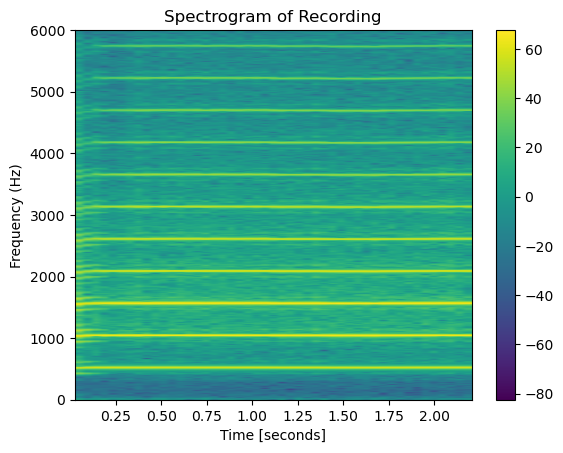

In [15]:
fanout(samples_to_spectrogram_and_peaks(song_one, 0.6)[2], 5)

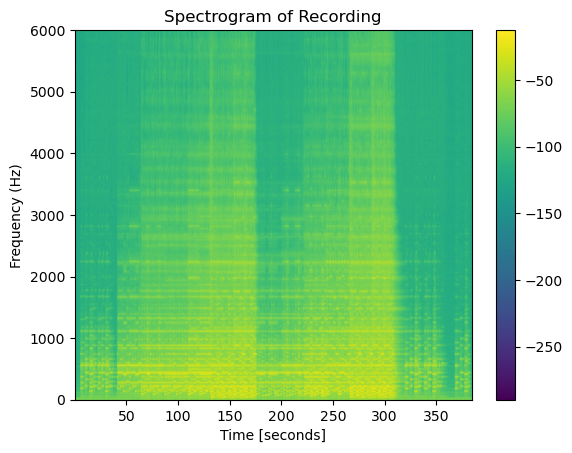

In [16]:
song_database = {}

song_one, sampling_rate = librosa_resample("data/trumpet.wav", 44100)
song_two, sampling_rate = librosa_resample("data/sean_secs.wav", 44100)
song_three, sampling_rate = librosa_resample("data/experience.mp3", 44100)

def load_songs(song_database, song, song_name):
    
    song_database[song_name] = fanout(samples_to_spectrogram_and_peaks(song, 0.6)[2], 5)

load_songs(song_database, song_one, "trumpet")
load_songs(song_database, song_two, "sean_secs")
load_songs(song_database, song_three, "experience")

In [21]:
len(song_database)

3

In [32]:
keys=[]
for i in song_database:
    keys.append(i)

In [64]:
dictionary = {"a":1, "b":2}
for i in (song_database[list(song_database.keys())[2]]):
    print(i)

((0, 0, 7), 1)
((0, 0, 15), 1)
((0, 0, 25), 1)
((0, 0, 28), 1)
((0, 0, 41), 1)
((0, 0, 8), 8)
((0, 0, 18), 8)
((0, 0, 21), 8)
((0, 0, 34), 8)
((0, 0, 42), 8)
((0, 0, 10), 16)
((0, 0, 13), 16)
((0, 0, 26), 16)
((0, 0, 34), 16)
((0, 0, 48), 16)
((0, 0, 3), 26)
((0, 0, 16), 26)
((0, 0, 24), 26)
((0, 0, 38), 26)
((0, 0, 51), 26)
((0, 0, 13), 29)
((0, 0, 21), 29)
((0, 0, 35), 29)
((0, 0, 48), 29)
((0, 0, 54), 29)
((0, 0, 8), 42)
((0, 0, 22), 42)
((0, 0, 35), 42)
((0, 0, 41), 42)
((0, 0, 44), 42)
((0, 0, 14), 50)
((0, 0, 27), 50)
((0, 0, 33), 50)
((0, 0, 36), 50)
((0, 0, 55), 50)
((0, 0, 13), 64)
((0, 0, 19), 64)
((0, 0, 22), 64)
((0, 0, 41), 64)
((0, 0, 45), 64)
((0, 0, 6), 77)
((0, 0, 9), 77)
((0, 0, 28), 77)
((0, 0, 32), 77)
((0, 0, 34), 77)
((0, 0, 3), 83)
((0, 0, 22), 83)
((0, 0, 26), 83)
((0, 0, 28), 83)
((0, 0, 32), 83)
((0, 0, 19), 86)
((0, 0, 23), 86)
((0, 0, 25), 86)
((0, 0, 29), 86)
((0, 0, 40), 86)
((0, 0, 4), 105)
((0, 0, 6), 105)
((0, 0, 10), 105)
((0, 0, 21), 105)
((0, 0, 23),

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




((1440, 1440, 8), 146)
((1440, 1440, 24), 146)
((1440, 1440, 41), 146)
((1440, 1440, 46), 146)
((1440, 1440, 71), 146)
((1440, 1440, 16), 154)
((1440, 1440, 33), 154)
((1440, 1440, 38), 154)
((1440, 1440, 63), 154)
((1440, 1440, 107), 154)
((1440, 1440, 17), 170)
((1440, 1440, 22), 170)
((1440, 1440, 47), 170)
((1440, 1440, 91), 170)
((1440, 1440, 127), 170)
((1440, 1440, 5), 187)
((1440, 1440, 30), 187)
((1440, 1440, 74), 187)
((1440, 1440, 110), 187)
((1440, 1440, 118), 187)
((1440, 1440, 25), 192)
((1440, 1440, 69), 192)
((1440, 1440, 105), 192)
((1440, 1440, 113), 192)
((1440, 1440, 126), 192)
((1440, 1440, 44), 217)
((1440, 1440, 80), 217)
((1440, 1440, 88), 217)
((1440, 1440, 101), 217)
((1440, 1440, 103), 217)
((1440, 1440, 36), 261)
((1440, 1440, 44), 261)
((1440, 1440, 57), 261)
((1440, 1440, 59), 261)
((1440, 1440, 64), 261)
((1440, 1440, 8), 297)
((1440, 1440, 21), 297)
((1440, 1440, 23), 297)
((1440, 1440, 28), 297)
((1440, 1440, 38), 297)
((1440, 1440, 13), 305)
((1440, 1

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




((2829, 2829, 63), 633)
((2829, 2829, 25), 642)
((2829, 2829, 29), 642)
((2829, 2829, 51), 642)
((2829, 2829, 54), 642)
((2829, 2829, 96), 642)
((2829, 2829, 4), 667)
((2829, 2829, 26), 667)
((2829, 2829, 29), 667)
((2829, 2829, 71), 667)
((2829, 2829, 85), 667)
((2829, 2829, 22), 671)
((2829, 2829, 25), 671)
((2829, 2829, 67), 671)
((2829, 2829, 81), 671)
((2829, 2829, 85), 671)
((2829, 2829, 3), 693)
((2829, 2829, 45), 693)
((2829, 2829, 59), 693)
((2829, 2829, 63), 693)
((2829, 2829, 67), 693)
((2829, 2829, 42), 696)
((2829, 2829, 56), 696)
((2829, 2829, 60), 696)
((2829, 2829, 64), 696)
((2829, 2829, 71), 696)
((2829, 2829, 14), 738)
((2829, 2829, 18), 738)
((2829, 2829, 22), 738)
((2829, 2829, 29), 738)
((2829, 2829, 34), 738)
((2829, 2829, 4), 752)
((2829, 2829, 8), 752)
((2829, 2829, 15), 752)
((2829, 2829, 20), 752)
((2829, 2829, 30), 752)
((2829, 2829, 4), 756)
((2829, 2829, 11), 756)
((2829, 2829, 16), 756)
((2829, 2829, 26), 756)
((2829, 2829, 28), 756)
((2829, 2829, 7), 76

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



((3059, 3059, 34), 711)
((3059, 3059, 7), 718)
((3059, 3059, 10), 718)
((3059, 3059, 13), 718)
((3059, 3059, 27), 718)
((3059, 3059, 66), 718)
((3059, 3059, 3), 725)
((3059, 3059, 6), 725)
((3059, 3059, 20), 725)
((3059, 3059, 59), 725)
((3059, 3059, 61), 725)
((3059, 3059, 3), 728)
((3059, 3059, 17), 728)
((3059, 3059, 56), 728)
((3059, 3059, 58), 728)
((3059, 3059, 89), 728)
((3059, 3059, 14), 731)
((3059, 3059, 53), 731)
((3059, 3059, 55), 731)
((3059, 3059, 86), 731)
((3059, 3059, 100), 731)
((3059, 3059, 39), 745)
((3059, 3059, 41), 745)
((3059, 3059, 72), 745)
((3059, 3059, 86), 745)
((3059, 3059, 112), 745)
((3059, 3059, 2), 784)
((3059, 3059, 33), 784)
((3059, 3059, 47), 784)
((3059, 3059, 73), 784)
((3059, 3059, 76), 784)
((3059, 3059, 31), 786)
((3059, 3059, 45), 786)
((3059, 3059, 71), 786)
((3059, 3059, 74), 786)
((3059, 3059, 80), 786)
((3059, 3059, 14), 817)
((3059, 3059, 40), 817)
((3059, 3059, 43), 817)
((3059, 3059, 49), 817)
((3059, 3059, 93), 817)
((3059, 3059, 26), 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



((3996, 3996, 88), 1038)
((3996, 3996, 127), 1038)
((3996, 3996, 162), 1038)
((3996, 3996, 75), 1044)
((3996, 3996, 82), 1044)
((3996, 3996, 121), 1044)
((3996, 3996, 156), 1044)
((3996, 3996, 160), 1044)
((3996, 3996, 7), 1119)
((3996, 3996, 46), 1119)
((3996, 3996, 81), 1119)
((3996, 3996, 85), 1119)
((3996, 3996, 90), 1119)
((3996, 3996, 39), 1126)
((3996, 3996, 74), 1126)
((3996, 3996, 78), 1126)
((3996, 3996, 83), 1126)
((3996, 3996, 129), 1126)
((3996, 3996, 35), 1165)
((3996, 3996, 39), 1165)
((3996, 3996, 44), 1165)
((3996, 3996, 90), 1165)
((3996, 3996, 96), 1165)
((3996, 3996, 4), 1200)
((3996, 3996, 9), 1200)
((3996, 3996, 55), 1200)
((3996, 3996, 61), 1200)
((3996, 3996, 65), 1200)
((3996, 3996, 5), 1204)
((3996, 3996, 51), 1204)
((3996, 3996, 57), 1204)
((3996, 3996, 61), 1204)
((3996, 3996, 97), 1204)
((3996, 3996, 46), 1209)
((3996, 3996, 52), 1209)
((3996, 3996, 56), 1209)
((3996, 3996, 92), 1209)
((3996, 3996, 97), 1209)
((3996, 3996, 6), 1255)
((3996, 3996, 10), 1255)

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




((4172, 4172, 22), 112)
((4172, 4172, 29), 112)
((4172, 4172, 32), 112)
((4172, 4172, 34), 112)
((4172, 4172, 11), 123)
((4172, 4172, 18), 123)
((4172, 4172, 21), 123)
((4172, 4172, 23), 123)
((4172, 4172, 55), 123)
((4172, 4172, 7), 134)
((4172, 4172, 10), 134)
((4172, 4172, 12), 134)
((4172, 4172, 44), 134)
((4172, 4172, 83), 134)
((4172, 4172, 3), 141)
((4172, 4172, 5), 141)
((4172, 4172, 37), 141)
((4172, 4172, 76), 141)
((4172, 4172, 81), 141)
((4172, 4172, 2), 144)
((4172, 4172, 34), 144)
((4172, 4172, 73), 144)
((4172, 4172, 78), 144)
((4172, 4172, 102), 144)
((4172, 4172, 32), 146)
((4172, 4172, 71), 146)
((4172, 4172, 76), 146)
((4172, 4172, 100), 146)
((4172, 4172, 103), 146)
((4172, 4172, 39), 178)
((4172, 4172, 44), 178)
((4172, 4172, 68), 178)
((4172, 4172, 71), 178)
((4172, 4172, 84), 178)
((4172, 4172, 5), 217)
((4172, 4172, 29), 217)
((4172, 4172, 32), 217)
((4172, 4172, 45), 217)
((4172, 4172, 49), 217)
((4172, 4172, 24), 222)
((4172, 4172, 27), 222)
((4172, 4172, 40)

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



((5152, 5152, 115), 1014)
((5152, 5152, 32), 1025)
((5152, 5152, 69), 1025)
((5152, 5152, 87), 1025)
((5152, 5152, 104), 1025)
((5152, 5152, 120), 1025)
((5152, 5152, 37), 1057)
((5152, 5152, 55), 1057)
((5152, 5152, 72), 1057)
((5152, 5152, 88), 1057)
((5152, 5152, 142), 1057)
((5152, 5152, 18), 1094)
((5152, 5152, 35), 1094)
((5152, 5152, 51), 1094)
((5152, 5152, 105), 1094)
((5152, 5152, 133), 1094)
((5152, 5152, 17), 1112)
((5152, 5152, 33), 1112)
((5152, 5152, 87), 1112)
((5152, 5152, 115), 1112)
((5152, 5152, 157), 1112)
((5152, 5152, 16), 1129)
((5152, 5152, 70), 1129)
((5152, 5152, 98), 1129)
((5152, 5152, 140), 1129)
((5152, 5152, 178), 1129)
((5152, 5152, 54), 1145)
((5152, 5152, 82), 1145)
((5152, 5152, 124), 1145)
((5152, 5152, 162), 1145)
((5152, 5152, 206), 1145)
((5152, 5152, 28), 1199)
((5152, 5152, 70), 1199)
((5152, 5152, 108), 1199)
((5152, 5152, 152), 1199)
((5152, 5152, 154), 1199)
((5152, 5152, 42), 1227)
((5152, 5152, 80), 1227)
((5152, 5152, 124), 1227)
((5152, 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




((5355, 5355, 84), 346)
((5355, 5355, 32), 349)
((5355, 5355, 46), 349)
((5355, 5355, 66), 349)
((5355, 5355, 81), 349)
((5355, 5355, 89), 349)
((5355, 5355, 14), 381)
((5355, 5355, 34), 381)
((5355, 5355, 49), 381)
((5355, 5355, 57), 381)
((5355, 5355, 59), 381)
((5355, 5355, 20), 395)
((5355, 5355, 35), 395)
((5355, 5355, 43), 395)
((5355, 5355, 45), 395)
((5355, 5355, 48), 395)
((5355, 5355, 15), 415)
((5355, 5355, 23), 415)
((5355, 5355, 25), 415)
((5355, 5355, 28), 415)
((5355, 5355, 33), 415)
((5355, 5355, 8), 430)
((5355, 5355, 10), 430)
((5355, 5355, 13), 430)
((5355, 5355, 18), 430)
((5355, 5355, 34), 430)
((5355, 5355, 2), 438)
((5355, 5355, 5), 438)
((5355, 5355, 10), 438)
((5355, 5355, 26), 438)
((5355, 5355, 42), 438)
((5355, 5355, 3), 440)
((5355, 5355, 8), 440)
((5355, 5355, 24), 440)
((5355, 5355, 40), 440)
((5355, 5355, 49), 440)
((5355, 5355, 5), 443)
((5355, 5355, 21), 443)
((5355, 5355, 37), 443)
((5355, 5355, 46), 443)
((5355, 5355, 64), 443)
((5355, 5355, 16), 44

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



((6385, 6385, 108), 1264)
((6385, 6385, 113), 1264)
((6385, 6385, 48), 1267)
((6385, 6385, 63), 1267)
((6385, 6385, 105), 1267)
((6385, 6385, 110), 1267)
((6385, 6385, 132), 1267)
((6385, 6385, 15), 1315)
((6385, 6385, 57), 1315)
((6385, 6385, 62), 1315)
((6385, 6385, 84), 1315)
((6385, 6385, 87), 1315)
((6385, 6385, 42), 1330)
((6385, 6385, 47), 1330)
((6385, 6385, 69), 1330)
((6385, 6385, 72), 1330)
((6385, 6385, 77), 1330)
((6385, 6385, 5), 1372)
((6385, 6385, 27), 1372)
((6385, 6385, 30), 1372)
((6385, 6385, 35), 1372)
((6385, 6385, 80), 1372)
((6385, 6385, 22), 1377)
((6385, 6385, 25), 1377)
((6385, 6385, 30), 1377)
((6385, 6385, 75), 1377)
((6385, 6385, 104), 1377)
((6385, 6385, 3), 1399)
((6385, 6385, 8), 1399)
((6385, 6385, 53), 1399)
((6385, 6385, 82), 1399)
((6385, 6386, -1398), 1399)
((6385, 6385, 5), 1402)
((6385, 6385, 50), 1402)
((6385, 6385, 79), 1402)
((6385, 6386, -1401), 1402)
((6385, 6386, -1362), 1402)
((6385, 6385, 45), 1407)
((6385, 6385, 74), 1407)
((6385, 6386, 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



((7270, 7270, 174), 936)
((7270, 7270, 50), 958)
((7270, 7270, 78), 958)
((7270, 7270, 103), 958)
((7270, 7270, 152), 958)
((7270, 7270, 183), 958)
((7270, 7270, 28), 1008)
((7270, 7270, 53), 1008)
((7270, 7270, 102), 1008)
((7270, 7270, 133), 1008)
((7270, 7270, 142), 1008)
((7270, 7270, 25), 1036)
((7270, 7270, 74), 1036)
((7270, 7270, 105), 1036)
((7270, 7270, 114), 1036)
((7270, 7270, 124), 1036)
((7270, 7270, 49), 1061)
((7270, 7270, 80), 1061)
((7270, 7270, 89), 1061)
((7270, 7270, 99), 1061)
((7270, 7270, 110), 1061)
((7270, 7270, 31), 1110)
((7270, 7270, 40), 1110)
((7270, 7270, 50), 1110)
((7270, 7270, 61), 1110)
((7270, 7270, 100), 1110)
((7270, 7270, 9), 1141)
((7270, 7270, 19), 1141)
((7270, 7270, 30), 1141)
((7270, 7270, 69), 1141)
((7270, 7270, 107), 1141)
((7270, 7270, 10), 1150)
((7270, 7270, 21), 1150)
((7270, 7270, 60), 1150)
((7270, 7270, 98), 1150)
((7270, 7270, 112), 1150)
((7270, 7270, 11), 1160)
((7270, 7270, 50), 1160)
((7270, 7270, 88), 1160)
((7270, 7270, 102)

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



((7437, 7437, 3), 79)
((7437, 7437, 13), 79)
((7437, 7437, 24), 79)
((7437, 7437, 30), 79)
((7437, 7437, 35), 79)
((7437, 7437, 10), 82)
((7437, 7437, 21), 82)
((7437, 7437, 27), 82)
((7437, 7437, 32), 82)
((7437, 7437, 41), 82)
((7437, 7437, 11), 92)
((7437, 7437, 17), 92)
((7437, 7437, 22), 92)
((7437, 7437, 31), 92)
((7437, 7437, 34), 92)
((7437, 7437, 6), 103)
((7437, 7437, 11), 103)
((7437, 7437, 20), 103)
((7437, 7437, 23), 103)
((7437, 7437, 27), 103)
((7437, 7437, 5), 109)
((7437, 7437, 14), 109)
((7437, 7437, 17), 109)
((7437, 7437, 21), 109)
((7437, 7437, 27), 109)
((7437, 7437, 9), 114)
((7437, 7437, 12), 114)
((7437, 7437, 16), 114)
((7437, 7437, 22), 114)
((7437, 7437, 30), 114)
((7437, 7437, 3), 123)
((7437, 7437, 7), 123)
((7437, 7437, 13), 123)
((7437, 7437, 21), 123)
((7437, 7437, 32), 123)
((7437, 7437, 4), 126)
((7437, 7437, 10), 126)
((7437, 7437, 18), 126)
((7437, 7437, 29), 126)
((7437, 7437, 35), 126)
((7437, 7437, 6), 130)
((7437, 7437, 14), 130)
((7437, 7437, 2

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [57]:
list(song_database.values())[0]

((0, 0, 7), 0)

In [65]:
def matching(song_database, new_song):
    new_fingerprints = fanout(samples_to_spectrogram_and_peaks(new_song, 0.6)[2], 5)
    percentages=[]
    tally=0
    
    for i in (list(song_database.values())[0]):
        tally=0
        for j in new_fingerprints:
            if j in i:
                tally+=1
        percentages.append(100*tally/len(new_fingerprints))

    #max_value = -1
    #stored_index=0
    
    #for i in range(len(percentages)):
    #    if percentages[i]>max_value:
    #        max_value=percentages[i]
    #        stored_index=i
    
    
    return song_database[song_database.keys()[np.argmax(percentages)]]

In [66]:
matching(song_database, song_three)

KeyboardInterrupt: 

Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x0000020076114C10> (for post_execute):



KeyboardInterrupt



Error in callback <function flush_figures at 0x0000020076274040> (for post_execute):



KeyboardInterrupt

